In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [19]:
CAMERA_PARAMS = np.load("stereo.npz")
K = CAMERA_PARAMS['camera_left_matrix']
calib_img_width = 640 # in px
calib_img_height = 480 # in px
act_img_width = 1280 # in px
act_img_height = 720 # in px
base_line_m = 0.06
scale_x = (act_img_width/calib_img_width)
scale_y = (act_img_height/calib_img_height)
fx = K[0, 0]*scale_x
fy = K[1, 1]*scale_y
cx = K[0, 2]*scale_x  # Camera center x in pixel cords
cy = K[1, 2]*scale_y  # Camera center y in pixel cords
fx,fy,u0,v0

(np.float64(885.0929346090537),
 np.float64(664.5702823356775),
 np.float64(615.0159937967898),
 np.float64(351.4691069599542))

In [15]:
def compute_3d_from_disparity_vectorized(disparity_map):
    h, w = disparity_map.shape
    x_coords, y_coords = np.meshgrid(np.arange(w), np.arange(h))

    valid = disparity_map > 0

    Z = np.zeros_like(disparity_map, dtype=np.float32)
    Z[valid] = fx * base_line_m / disparity_map[valid]

    X = np.zeros_like(disparity_map, dtype=np.float32)
    Y = np.zeros_like(disparity_map, dtype=np.float32)
    X[valid] = (x_coords[valid] - cx) * Z[valid] / fx
    Y[valid] = (y_coords[valid] - cy) * Z[valid] / fy

    points_3d = np.full((h, w, 3), np.nan, dtype=np.float32)
    points_3d[:, :, 0] = X
    points_3d[:, :, 1] = Y
    points_3d[:, :, 2] = Z

    return points_3d


def visualize_3d_points(points_3d, sample_step=5, max_points=10000):
    # Flatten and sample points
    flat_points = points_3d.reshape(-1, 3)
    valid_points = flat_points[~np.isnan(flat_points).any(axis=1)]

    if len(valid_points) > max_points:
        indices = np.random.choice(len(valid_points), max_points, replace=False)
        valid_points = valid_points[indices]

    X, Y, Z = valid_points[:, 0], valid_points[:, 1], valid_points[:, 2]

    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(X, Y, Z, s=0.5, c=Z, cmap='jet')
    ax.set_xlabel("X (m)")
    ax.set_ylabel("Y (m)")
    ax.set_zlabel("Z (m)")
    plt.title("3D Point Cloud")
    plt.show()


In [6]:
def feature_match(imgL, imgR, match_points=20):
    """
    Perform ORB feature matching between stereo images and compute average disparity.

    Args:
        imgL (np.ndarray): Left grayscale image.
        imgR (np.ndarray): Right grayscale image.
        match_points (int): Number of top matches to consider.

    Returns:
        avg_disparity (float): Average disparity in pixels.
        img_matches (np.ndarray): Image showing top N matches with indices.
        points (List[Tuple[Tuple[int, int], Tuple[int, int]]]): Matched point coordinates.
    """
    orb = cv2.ORB_create(nfeatures=1000)

    kp1, des1 = orb.detectAndCompute(imgL, None)
    kp2, des2 = orb.detectAndCompute(imgR, None)

    if des1 is None or des2 is None:
        print("[Warning] No descriptors found.")
        return 0, None, []

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)

    img_matches = cv2.drawMatches(imgL, kp1, imgR, kp2, matches[:match_points], None, flags=2)

    avg_disparity = 0
    points = []

    offset = imgL.shape[1]  # width of the left image

    for i, match in enumerate(matches[:match_points]):
        pt_left = tuple(map(int, kp1[match.queryIdx].pt))
        pt_right = tuple(map(int, kp2[match.trainIdx].pt))

        disparity = pt_left[0] - pt_right[0]
        avg_disparity += disparity
        points.append((pt_left, pt_right))

        # Annotate match index
        cv2.putText(img_matches, str(i), pt_left, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
        pt_right_offset = (pt_right[0] + offset, pt_right[1])
        cv2.putText(img_matches, str(i), pt_right_offset, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    avg_disparity /= match_points
    return avg_disparity, img_matches, points

def get_depth(disparity, pixel_x, pixel_y):
    """
    Returns the 3D coordinate (X, Y, Z) in meters of a pixel using stereo vision.
    
    Parameters:
    - disparity: disparity value at the pixel
    - pixel_x, pixel_y: pixel coordinates in the left image

    Returns:
    - (X, Y, Z): 3D coordinates in meters
    """
    if disparity <= 0:
        return None  # or (np.nan, np.nan, np.nan)

    baseline_m = 0.06  # baseline in meters (60mm)

    xL = pixel_x - u0
    yL = pixel_y - v0

    Z = (fx * baseline_m) / disparity
    X = (xL * Z) / fx
    Y = (yL * Z) / fy

    return (X, Y, Z)

def depth_mapper(frame_left,frame_right):
    """
    Compute depth map from stereo images using StereoBM.

    Args:
        frame_left (np.ndarray): Left image (BGR).
        frame_right (np.ndarray): Right image (BGR).

    Returns:
        depth_map (np.ndarray): Depth map (Z in meters).
    """
    # --- StereoBM matcher ---
    stereo = cv2.StereoBM_create(numDisparities=64, blockSize=15)
    # For better quality, consider: cv2.StereoSGBM_create(...)

    # --- Camera parameters ---
    f_mm = 2.6  # focal length in mm
    sensor_width_mm = 3.6
    sensor_height_mm = 2.7
    baseline_m = 0.06  # baseline in meters

    image_width_px = frame_left.shape[1]
    image_height_px = frame_left.shape[0]

    # Convert focal length from mm to pixels
    fx = (f_mm * image_width_px) / sensor_width_mm
    fy = (f_mm * image_height_px) / sensor_height_mm

    # --- Grayscale conversion ---
    gray_left = cv2.cvtColor(frame_left, cv2.COLOR_BGR2GRAY)
    gray_right = cv2.cvtColor(frame_right, cv2.COLOR_BGR2GRAY)

    # --- Compute disparity ---
    disparity = stereo.compute(gray_left, gray_right).astype(np.float32) / 16.0

    # --- Prevent division by zero or very low disparity values ---
    disparity[disparity <= 0.1] = 0.1

    # --- Compute depth map ---
    depth_map = (fx * baseline_m) / disparity

    return depth_map

In [11]:
imgL_raw = cv2.imread("img_left.jpg")
imgR_raw = cv2.imread("img_right.jpg")

imgL_gray = cv2.cvtColor(imgL_raw,cv2.COLOR_RGB2GRAY)
imgR_gray = cv2.cvtColor(imgR_raw,cv2.COLOR_RGB2GRAY)

imgL_raw.shape

(720, 1280, 3)

In [60]:
# StereoBM for disparity map (adjust numDisparities and blockSize as needed)
stereo = cv2.StereoBM_create(numDisparities=32, blockSize=9)  # Try blockSize = 9 to 21

# Optional tuning (fine-tune as needed)
stereo.setPreFilterType(1)
stereo.setPreFilterSize(9)
stereo.setPreFilterCap(31)
stereo.setMinDisparity(0)
stereo.setTextureThreshold(10)
stereo.setUniquenessRatio(15)
stereo.setSpeckleRange(32)
stereo.setSpeckleWindowSize(100)

In [61]:

disparity_raw = stereo.compute(imgL_gray, imgR_gray).astype(np.float32) / 16.0

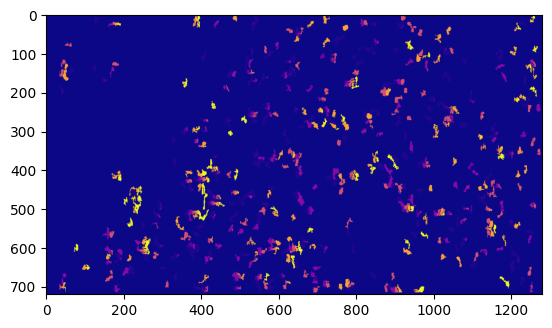

In [62]:
plt.imshow(disparity_raw,cmap='plasma')

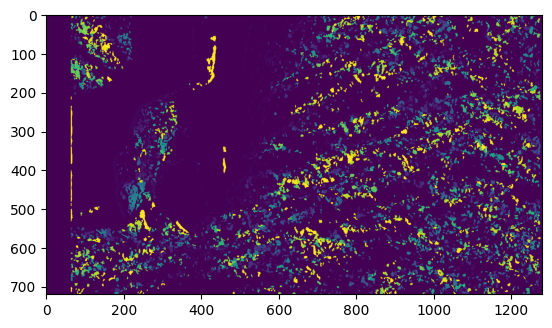

In [63]:
# Setting parameters for StereoSGBM algorithm
minDisparity = 0;
numDisparities = 64;
blockSize = 8;
disp12MaxDiff = 1;
uniquenessRatio = 10;
speckleWindowSize = 10;
speckleRange = 8;
 
# Creating an object of StereoSGBM algorithm
stereo = cv2.StereoSGBM_create(minDisparity = minDisparity,
        numDisparities = numDisparities,
        blockSize = blockSize,
        disp12MaxDiff = disp12MaxDiff,
        uniquenessRatio = uniquenessRatio,
        speckleWindowSize = speckleWindowSize,
        speckleRange = speckleRange
    )
 
# Calculating disparith using the StereoSGBM algorithm
disp = stereo.compute(imgL_gray, imgR_gray).astype(np.float32)
disp = cv2.normalize(disp,0,255,cv2.NORM_MINMAX)
 
# Displaying the disparity map
plt.imshow(disp)

In [20]:
# Compute 3D points
points_3d = compute_3d_from_disparity_vectorized(disparity_raw)

In [ ]:
import numpy as np
import open3d as o3d

def numpy_to_open3d(points, colors):
    # Create point cloud object
    pcd = o3d.geometry.PointCloud()

    # Convert to float32 and assign
    pcd.points = o3d.utility.Vector3dVector(points.astype(np.float32))
    pcd.colors = o3d.utility.Vector3dVector(colors.astype(np.float32) / 255.0)

    return pcd

# Assuming you already have `output_points` and `output_colors` from disparity
pcd = numpy_to_open3d(output_points, output_colors)

# Visualize
o3d.visualization.draw_geometries([pcd])

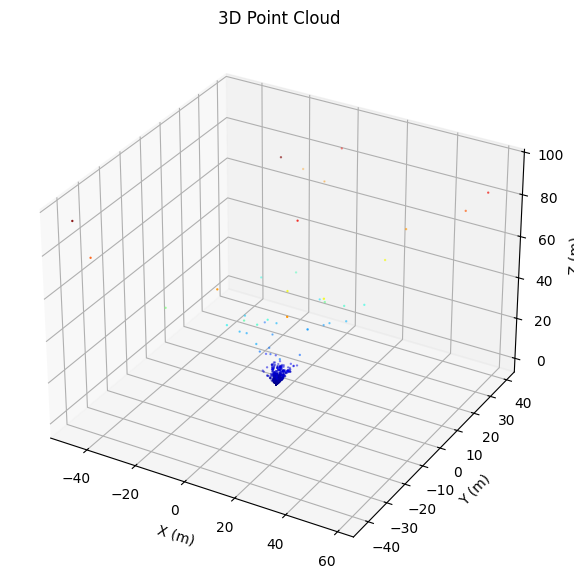

In [21]:

# Visualize
visualize_3d_points(points_3d)


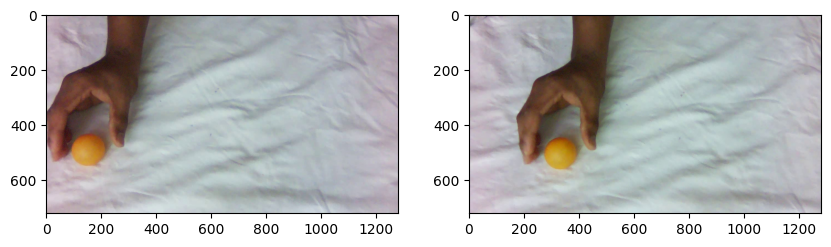

In [158]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121)
ax1.imshow(cv2.cvtColor(imgL_raw, cv2.COLOR_BGR2RGB))
ax2 = fig.add_subplot(122)
ax2.imshow(cv2.cvtColor(imgR_raw, cv2.COLOR_BGR2RGB))

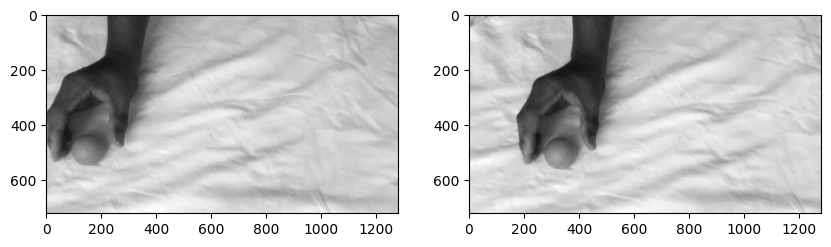

In [160]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121)
ax1.imshow(imgL_gray,cmap='gray')
ax2 = fig.add_subplot(122)
ax2.imshow(imgR_gray,cmap='gray')

In [196]:
disparity,img_key_points,key_points = feature_match(imgL_raw,imgR_raw,10)
disparity

-165.9

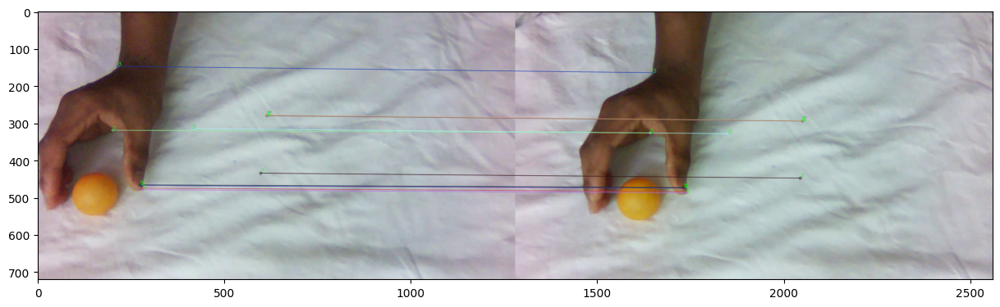

In [197]:
fig = plt.figure(figsize=(15,7.5))
ax = fig.add_subplot(111)
ax.imshow(cv2.cvtColor(img_key_points,cv2.COLOR_RGB2BGR))

-84.9


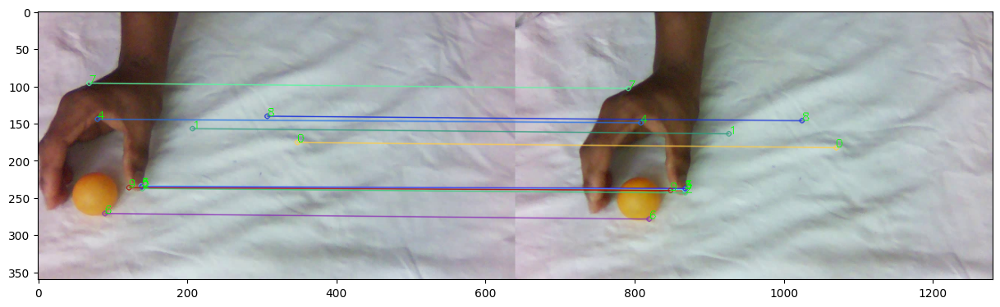

In [198]:
imgL = cv2.resize(imgL_raw, (0, 0), fx=scale, fy=scale)
imgR = cv2.resize(imgR_raw, (0, 0), fx=scale, fy=scale)
desparity,img_key_points,key_points = feature_match(imgL,imgR,10)
fig = plt.figure(figsize=(15,7.5))
ax = fig.add_subplot(111)
ax.imshow(cv2.cvtColor(img_key_points,cv2.COLOR_RGB2BGR))
print(desparity)

In [201]:
CAMERA_PARAMS = np.load("stereo.npz")
K = CAMERA_PARAMS['camera_left_matrix']
fx = K[0, 0]
fy = K[1, 1]
u0 = K[0, 2]
v0 = K[1, 2]

baseline_m = 0.06  # baseline in meters (60mm)

In [202]:
h,w,_ = imgR_raw.shape
point3D = np.zeros((3,h*w))
point3D.shape

(3, 921600)

In [209]:
k = 0
for i in range(h):
    for j in range(w):
        Z = (fx * baseline_m) / disparity
        X = ((i - u0) * Z) / fx
        Y = ((j - v0) * Z) / fy
        print(X,Y,Z)
        point3D[:,k] = np.array([X,Y,Z])

0.11121446542437427 0.08464669064406974 -0.16005297190037138
0.11121446542437427 0.08428543546274148 -0.16005297190037138
0.11121446542437427 0.08392418028141319 -0.16005297190037138
0.11121446542437427 0.08356292510008491 -0.16005297190037138
0.11121446542437427 0.08320166991875665 -0.16005297190037138
0.11121446542437427 0.08284041473742837 -0.16005297190037138
0.11121446542437427 0.08247915955610009 -0.16005297190037138
0.11121446542437427 0.08211790437477183 -0.16005297190037138
0.11121446542437427 0.08175664919344354 -0.16005297190037138
0.11121446542437427 0.08139539401211528 -0.16005297190037138
0.11121446542437427 0.081034138830787 -0.16005297190037138
0.11121446542437427 0.08067288364945872 -0.16005297190037138
0.11121446542437427 0.08031162846813046 -0.16005297190037138
0.11121446542437427 0.07995037328680218 -0.16005297190037138
0.11121446542437427 0.0795891181054739 -0.16005297190037138
0.11121446542437427 0.07922786292414563 -0.16005297190037138
0.11121446542437427 0.07886

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.16005297190037138
0.07468643649128207 -0.23903795182606333 -0.16005297190037138
0.07468643649128207 -0.2393992070073916 -0.16005297190037138
0.07468643649128207 -0.23976046218871985 -0.16005297190037138
0.07468643649128207 -0.24012171737004812 -0.16005297190037138
0.07468643649128207 -0.2404829725513764 -0.16005297190037138
0.07468643649128207 -0.24084422773270467 -0.16005297190037138
0.07468643649128207 -0.24120548291403293 -0.16005297190037138
0.07468643649128207 -0.24156673809536125 -0.16005297190037138
0.07468643649128207 -0.2419279932766895 -0.16005297190037138
0.07468643649128207 -0.24228924845801778 -0.16005297190037138
0.07468643649128207 -0.24265050363934607 -0.16005297190037138
0.07468643649128207 -0.24301175882067433 -0.16005297190037138
0.07468643649128207 -0.2433730140020026 -0.16005297190037138
0.07468643649128207 -0.24373426918333088 -0.16005297190037138
0.07468643649128207 -0.24409552436465914 -0.16005297190037138
0.07468643649128207 -0.2444567795459874 -0.1600529719

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 -0.34994329249384326 -0.16005297190037138
0.032371789113343534 -0.35030454767517155 -0.16005297190037138
0.032371789113343534 -0.35066580285649984 -0.16005297190037138
0.032371789113343534 -0.35102705803782813 -0.16005297190037138
0.032371789113343534 -0.35138831321915637 -0.16005297190037138
0.032371789113343534 -0.35174956840048466 -0.16005297190037138
0.032371789113343534 -0.35211082358181295 -0.16005297190037138
0.032371789113343534 -0.3524720787631412 -0.16005297190037138
0.032371789113343534 -0.3528333339444695 -0.16005297190037138
0.032371789113343534 -0.35319458912579776 -0.16005297190037138
0.032371789113343534 -0.353555844307126 -0.16005297190037138
0.032371789113343534 -0.3539170994884543 -0.16005297190037138
0.032371789113343534 -0.3542783546697826 -0.16005297190037138
0.032371789113343534 -0.3546396098511108 -0.16005297190037138
0.032371789113343534 -0.3550008650324391 -0.16005297190037138
0.032371789113343534 -0.3553621202137674 -0.16005297190037138
0.032371789113343534 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.00668788538936894 -0.019756056759801303 -0.16005297190037138
-0.00668788538936894 -0.020117311941129576 -0.16005297190037138
-0.00668788538936894 -0.020478567122457846 -0.16005297190037138
-0.00668788538936894 -0.020839822303786122 -0.16005297190037138
-0.00668788538936894 -0.021201077485114392 -0.16005297190037138
-0.00668788538936894 -0.02156233266644267 -0.16005297190037138
-0.00668788538936894 -0.02192358784777094 -0.16005297190037138
-0.00668788538936894 -0.022284843029099215 -0.16005297190037138
-0.00668788538936894 -0.022646098210427488 -0.16005297190037138
-0.00668788538936894 -0.023007353391755764 -0.16005297190037138
-0.00668788538936894 -0.023368608573084034 -0.16005297190037138
-0.00668788538936894 -0.02372986375441231 -0.16005297190037138
-0.00668788538936894 -0.02409111893574058 -0.16005297190037138
-0.00668788538936894 -0.024452374117068857 -0.16005297190037138
-0.00668788538936894 -0.02481362929839713 -0.16005297190037138
-0.00668788538936894 -0.025174884479725403 -0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




-0.017176131320652845 -0.016143504946518564 -0.16005297190037138
-0.017176131320652845 -0.01650476012784684 -0.16005297190037138
-0.017176131320652845 -0.016866015309175114 -0.16005297190037138
-0.017176131320652845 -0.017227270490503387 -0.16005297190037138
-0.017176131320652845 -0.01758852567183166 -0.16005297190037138
-0.017176131320652845 -0.017949780853159934 -0.16005297190037138
-0.017176131320652845 -0.018311036034488207 -0.16005297190037138
-0.017176131320652845 -0.01867229121581648 -0.16005297190037138
-0.017176131320652845 -0.019033546397144756 -0.16005297190037138
-0.017176131320652845 -0.019394801578473026 -0.16005297190037138
-0.017176131320652845 -0.019756056759801303 -0.16005297190037138
-0.017176131320652845 -0.020117311941129576 -0.16005297190037138
-0.017176131320652845 -0.020478567122457846 -0.16005297190037138
-0.017176131320652845 -0.020839822303786122 -0.16005297190037138
-0.017176131320652845 -0.021201077485114392 -0.16005297190037138
-0.017176131320652845 -0.02

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.16005297190037138
-0.045747559892081416 -0.30334137410249595 -0.16005297190037138
-0.045747559892081416 -0.30370262928382424 -0.16005297190037138
-0.045747559892081416 -0.3040638844651526 -0.16005297190037138
-0.045747559892081416 -0.3044251396464808 -0.16005297190037138
-0.045747559892081416 -0.3047863948278091 -0.16005297190037138
-0.045747559892081416 -0.3051476500091374 -0.16005297190037138
-0.045747559892081416 -0.30550890519046564 -0.16005297190037138
-0.045747559892081416 -0.30587016037179393 -0.16005297190037138
-0.045747559892081416 -0.3062314155531222 -0.16005297190037138
-0.045747559892081416 -0.30659267073445046 -0.16005297190037138
-0.045747559892081416 -0.30695392591577875 -0.16005297190037138
-0.045747559892081416 -0.30731518109710704 -0.16005297190037138
-0.045747559892081416 -0.3076764362784353 -0.16005297190037138
-0.045747559892081416 -0.30803769145976356 -0.16005297190037138
-0.045747559892081416 -0.3083989466410918 -0.16005297190037138
-0.045747559892081416 -0.3

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.05876745139298557 -0.31201149845437454 -0.16005297190037138
-0.05876745139298557 -0.3123727536357028 -0.16005297190037138
-0.05876745139298557 -0.31273400881703106 -0.16005297190037138
-0.05876745139298557 -0.3130952639983594 -0.16005297190037138
-0.05876745139298557 -0.3134565191796877 -0.16005297190037138
-0.05876745139298557 -0.31381777436101593 -0.16005297190037138
-0.05876745139298557 -0.3141790295423442 -0.16005297190037138
-0.05876745139298557 -0.3145402847236725 -0.16005297190037138
-0.05876745139298557 -0.31490153990500075 -0.16005297190037138
-0.05876745139298557 -0.31526279508632904 -0.16005297190037138
-0.05876745139298557 -0.31562405026765733 -0.16005297190037138
-0.05876745139298557 -0.31598530544898557 -0.16005297190037138
-0.05876745139298557 -0.31634656063031386 -0.16005297190037138
-0.05876745139298557 -0.31670781581164215 -0.16005297190037138
-0.05876745139298557 -0.3170690709929704 -0.16005297190037138
-0.05876745139298557 -0.31743032617429867 -0.1600529719003713

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.08733887996441414 -0.0905620723001429 -0.16005297190037138
-0.08733887996441414 -0.09092332748147117 -0.16005297190037138
-0.08733887996441414 -0.09128458266279944 -0.16005297190037138
-0.08733887996441414 -0.09164583784412773 -0.16005297190037138
-0.08733887996441414 -0.092007093025456 -0.16005297190037138
-0.08733887996441414 -0.09236834820678427 -0.16005297190037138
-0.08733887996441414 -0.09272960338811256 -0.16005297190037138
-0.08733887996441414 -0.09309085856944083 -0.16005297190037138
-0.08733887996441414 -0.0934521137507691 -0.16005297190037138
-0.08733887996441414 -0.09381336893209738 -0.16005297190037138
-0.08733887996441414 -0.09417462411342564 -0.16005297190037138
-0.08733887996441414 -0.09453587929475392 -0.16005297190037138
-0.08733887996441414 -0.0948971344760822 -0.16005297190037138
-0.08733887996441414 -0.09525838965741047 -0.16005297190037138
-0.08733887996441414 -0.09561964483873875 -0.16005297190037138
-0.08733887996441414 -0.09598090002006701 -0.160052971900371

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.09963544415971252 -0.18412716426416575 -0.16005297190037138
-0.09963544415971252 -0.18448841944549402 -0.16005297190037138
-0.09963544415971252 -0.18484967462682228 -0.16005297190037138
-0.09963544415971252 -0.18521092980815054 -0.16005297190037138
-0.09963544415971252 -0.18557218498947883 -0.16005297190037138
-0.09963544415971252 -0.18593344017080712 -0.16005297190037138
-0.09963544415971252 -0.1862946953521354 -0.16005297190037138
-0.09963544415971252 -0.18665595053346368 -0.16005297190037138
-0.09963544415971252 -0.18701720571479194 -0.16005297190037138
-0.09963544415971252 -0.1873784608961202 -0.16005297190037138
-0.09963544415971252 -0.1877397160774485 -0.16005297190037138
-0.09963544415971252 -0.18810097125877676 -0.16005297190037138
-0.09963544415971252 -0.18846222644010502 -0.16005297190037138
-0.09963544415971252 -0.1888234816214333 -0.16005297190037138
-0.09963544415971252 -0.18918473680276157 -0.16005297190037138
-0.09963544415971252 -0.18954599198408983 -0.16005297190037

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.09561964483873875 -0.16005297190037138
-0.1274835454255353 -0.09598090002006701 -0.16005297190037138
-0.1274835454255353 -0.09634215520139529 -0.16005297190037138
-0.1274835454255353 -0.09670341038272355 -0.16005297190037138
-0.1274835454255353 -0.09706466556405184 -0.16005297190037138
-0.1274835454255353 -0.09742592074538012 -0.16005297190037138
-0.1274835454255353 -0.09778717592670838 -0.16005297190037138
-0.1274835454255353 -0.09814843110803666 -0.16005297190037138
-0.1274835454255353 -0.09850968628936493 -0.16005297190037138
-0.1274835454255353 -0.0988709414706932 -0.16005297190037138
-0.1274835454255353 -0.09923219665202149 -0.16005297190037138
-0.1274835454255353 -0.09959345183334975 -0.16005297190037138
-0.1274835454255353 -0.09995470701467803 -0.16005297190037138
-0.1274835454255353 -0.1003159621960063 -0.16005297190037138
-0.1274835454255353 -0.10067721737733457 -0.16005297190037138
-0.1274835454255353 -0.10103847255866284 -0.16005297190037138
-0.1274835454255353 -0.1013997

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



-0.16005297190037138
-0.14267341884325682 -0.09670341038272355 -0.16005297190037138
-0.14267341884325682 -0.09706466556405184 -0.16005297190037138
-0.14267341884325682 -0.09742592074538012 -0.16005297190037138
-0.14267341884325682 -0.09778717592670838 -0.16005297190037138
-0.14267341884325682 -0.09814843110803666 -0.16005297190037138
-0.14267341884325682 -0.09850968628936493 -0.16005297190037138
-0.14267341884325682 -0.0988709414706932 -0.16005297190037138
-0.14267341884325682 -0.09923219665202149 -0.16005297190037138
-0.14267341884325682 -0.09959345183334975 -0.16005297190037138
-0.14267341884325682 -0.09995470701467803 -0.16005297190037138
-0.14267341884325682 -0.1003159621960063 -0.16005297190037138
-0.14267341884325682 -0.10067721737733457 -0.16005297190037138
-0.14267341884325682 -0.10103847255866284 -0.16005297190037138
-0.14267341884325682 -0.1013997277399911 -0.16005297190037138
-0.14267341884325682 -0.1017609829213194 -0.16005297190037138
-0.14267341884325682 -0.10212223810264

In [212]:
# depth_map = depth_mapper(imgL_raw,imgR_raw)
# plt.imshow(depth_map)

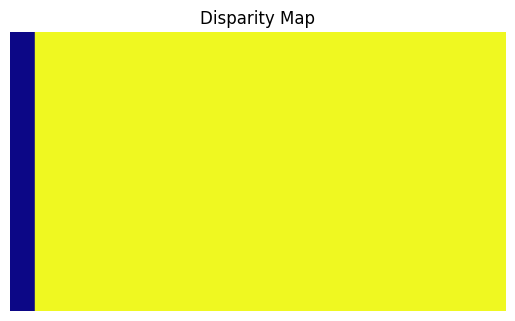

In [168]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load rectified stereo images
imgL = cv2.imread("img_left.jpg", cv2.IMREAD_GRAYSCALE)
imgR = cv2.imread("img_left.jpg", cv2.IMREAD_GRAYSCALE)

# StereoSGBM matcher for better quality
stereo = cv2.StereoSGBM_create(
    numDisparities=64,  # must be divisible by 16
    blockSize=9,
    P1=8 * 3 * 3**2,
    P2=32 * 3 * 3**2,
    disp12MaxDiff=1,
    uniquenessRatio=15,
    speckleWindowSize=50,
    speckleRange=2
)

# Compute disparity map
disparity = stereo.compute(imgL, imgR).astype(np.float32) / 16.0

# Optional: Normalize for display
disp_vis = cv2.normalize(disparity, None, 0, 255, cv2.NORM_MINMAX)
disp_vis = np.uint8(disp_vis)
plt.imshow(disp_vis, cmap='plasma')
plt.title("Disparity Map")
plt.axis("off")
plt.show()

In [170]:
# Load Q matrix from stereo calibration
# Q is usually generated from cv2.stereoRectify()
Q =  np.array([[1, 0, 0, -307.50],
     [0, 1, 0, -234.31],
     [0, 0, 0, 462.22],
     [0, 0, -1/0.06, 0]])

# Convert disparity to 3D
points_3D = cv2.reprojectImageTo3D(disparity, Q)

# Create a mask to remove zero disparity
mask = disparity > disparity.min()
output_points = points_3D[mask]
output_colors = imgL_raw[mask]  # get color from left image

# Save to .ply
def write_ply(filename, verts, colors):
    verts = verts.reshape(-1, 3)
    colors = colors.reshape(-1, 3)
    with open(filename, 'w') as f:
        f.write(f"ply\nformat ascii 1.0\nelement vertex {len(verts)}\n")
        f.write("property float x\nproperty float y\nproperty float z\n")
        f.write("property uchar red\nproperty uchar green\nproperty uchar blue\nend_header\n")
        for v, c in zip(verts, colors):
            f.write(f"{v[0]} {v[1]} {v[2]} {c[2]} {c[1]} {c[0]}\n")  # OpenCV uses BGR

write_ply("point_cloud.ply", output_points, output_colors)
print("Saved point cloud to point_cloud.ply")


Saved point cloud to point_cloud.ply


In [213]:
import open3d as o3d

# Load the point cloud from file
pcd = o3d.io.read_point_cloud("point_cloud.ply")

# Visualize the point cloud
o3d.visualization.draw_geometries([pcd])


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
[Open3D WARNING] Read PLY failed: unable to read file: point_cloud.ply
[Open3D WARNING] [ViewControl] SetViewPoint() failed because window height and width are not set.
[Open3D WARNING] [ViewControl] SetViewPoint() failed because window height and width are not set.
[Open3D WARNING] [ViewControl] SetViewPoint() failed because window height and width are not set.
[Open3D WARNING] [ViewControl] SetViewPoint() failed because window height and width are not set.


In [21]:
for key in CAMERA_PARAMS.keys():
    print(key)
    print(CAMERA_PARAMS[key])

camera_left_matrix
[[442.5464673    0.         307.5079969 ]
 [  0.         443.04685489 234.31273797]
 [  0.           0.           1.        ]]
camera_right_matrix
[[428.6662151    0.         311.76707533]
 [  0.         428.99801136 243.68696043]
 [  0.           0.           1.        ]]
distorsion_left
[[-5.56011070e-02  5.38924163e-01 -8.84444002e-04  5.45024188e-04
  -9.94981958e-01]]
distorsion_right
[[ 0.0106431   0.06072908  0.00053194  0.00244054 -0.13429586]]
rotation_matrix
[[ 9.99961778e-01  7.31157541e-04 -8.71251860e-03]
 [-1.00381307e-03  9.99508543e-01 -3.13315244e-02]
 [ 8.68532850e-03  3.13390726e-02  9.99471074e-01]]
translational_vector
[[-6.19966545]
 [ 0.13278348]
 [-0.79237622]]
